# Relations avec les institutions et spatialisation

In [1]:
### Noter qu'il faudra avoir installé toutes les librairies nécessaires
# dans l'environnement conda utilisé pour exécuter ce carnet
import pandas as pd
import geopandas as gpd
from shapely.geometry import LineString
from geopandas.tools import sjoin
from geodatasets import get_path
import networkx as nx
import matplotlib.pyplot as plt
import plotly.express as px
from itables import init_notebook_mode, show
import numpy as np
import seaborn as sns
import json
import IPython

## Production des données

* Requête exécutée sur le serveur https://dbpedia.org/sparql 
* Période élargie jusqu'aux comtemporains-nes
* Propriétés prises en compte après inspection des propriétés de la population:
  * http://dbpedia.org/ontology/almaMater 
  * http://dbpedia.org/ontology/institution
* On ajoute les coordonnées géographiques
* Noter que la structure de la requête (sans clause OPTIONAL) exclut toutes les personnes pour lequelles une variable manque

```SPARQL
PREFIX dbr: <http://dbpedia.org/resource/>
PREFIX dbp: <http://dbpedia.org/property/>
PREFIX dbo: <http://dbpedia.org/ontology/>
PREFIX rdfs:<http://www.w3.org/2000/01/rdf-schema#>
SELECT DISTINCT (?o1 AS ?subject_uri) ?subjectBirthDate ?birthPlace ?birthPoint ?r_property ?organisation ?orgPoint
# (COUNT(*) AS ?effectif) 
WHERE {
  SELECT DISTINCT ?o1 ?subjectBirthDate  ?birthPlace ?birthPoint ?r_property ?organisation ?orgPoint
  WHERE { 
    {
          {dbr:List_of_astronomers ?p ?o1.}
      UNION
          {dbr:List_of_astrologers ?p ?o1.}
      UNION
          {?o1 ?p dbr:Astrologer.}
      UNION
          {?o1 ?p dbr:Astronomer.}
      UNION
          {?o1 ?p dbr:Mathematician.}
    }
    ?o1 a dbo:Person;
      dbp:birthDate | dbo:birthDate ?subjectBirthDate;
      dbo:birthPlace ?birthPlace.
?birthPlace georss:point ?birthPoint;
     a  dbo:Settlement.
{
        {?o1 dbo:almaMater ?organisation.
     BIND('almaMater' AS ?r_property) }
UNION  {?o1 dbo:institution ?organisation.
     BIND('institution' AS ?r_property) }
}
?organisation  georss:point ?orgPoint.

    BIND(xsd:integer(SUBSTR(STR(?subjectBirthDate), 1, 4)) AS ?birthYear)
    FILTER ( (?birthYear >= 1451   ) )
 
          }
  ORDER BY ?birthYear
  }

```

## Inspecter les données

In [2]:
### Ouvrir le fichier et créer un DataFrame
fd = 'data/dbpedia_sparql_reseaux_spatialisation.csv'
df = pd.read_csv(fd)
len(df), df.head(2)

(4154,
                                          subject_uri subjectBirthDate  \
 0  http://dbpedia.org/resource/Domenico_Maria_Nov...       1454-08-01   
 1     http://dbpedia.org/resource/Scipione_del_Ferro       1465-02-06   
 
                             birthPlace                             birthPoint  \
 0  http://dbpedia.org/resource/Ferrara  44.833333333333336 11.616666666666667   
 1  http://dbpedia.org/resource/Bologna   44.49388888888889 11.342777777777778   
 
   r_property                                       organisation  \
 0  almaMater  http://dbpedia.org/resource/University_of_Flor...   
 1  almaMater  http://dbpedia.org/resource/University_of_Bologna   
 
                                orgPoint  
 0  43.77777777777778 11.258611111111112  
 1  44.49388888888889 11.342777777777778  )

In [3]:
### Raccourcir l'URI, extraire l'année de naissance
df['subject_uri'] = df['subject_uri'].apply(lambda x : x.replace('http://dbpedia.org/resource/', ''))
df['organisation'] = df['organisation'].apply(lambda x : x.replace('http://dbpedia.org/resource/', ''))
df['birthPlace'] = df['birthPlace'].apply(lambda x : x.replace('http://dbpedia.org/resource/', ''))
df['BirthYear'] = df['subjectBirthDate'].apply(lambda x : int(x[:4]))

In [4]:
### Séparer longitude et latitude, arrondir
df['latitudeBirth'] = df['birthPoint'].apply(lambda x : round(float((x.split(' ')[0])), 4))
df['longitudeBirth'] = df['birthPoint'].apply(lambda x : round(float((x.split(' ')[1])), 4))
df['latitudeOrg'] = df['orgPoint'].apply(lambda x : round(float((x.split(' ')[0])), 4))
df['longitudeOrg'] = df['orgPoint'].apply(lambda x : round(float((x.split(' ')[1])), 4))
df.head(2)

,subject_uri,subjectBirthDate,birthPlace,birthPoint,r_property,organisation,orgPoint,BirthYear,latitudeBirth,longitudeBirth,latitudeOrg,longitudeOrg
0,Domenico_Maria_Novara_da_Ferrara,1454-08-01,Ferrara,44.833333333333336 11.616666666666667,almaMater,University_of_Florence,43.77777777777778 11.258611111111112,1454,44.8333,11.6167,43.7778,11.2586
1,Scipione_del_Ferro,1465-02-06,Bologna,44.49388888888889 11.342777777777778,almaMater,University_of_Bologna,44.49388888888889 11.342777777777778,1465,44.4939,11.3428,44.4939,11.3428


In [5]:
### Inspecter le DataFrame
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4154 entries, 0 to 4153
Data columns (total 12 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   subject_uri       4154 non-null   object 
 1   subjectBirthDate  4154 non-null   object 
 2   birthPlace        4154 non-null   object 
 3   birthPoint        4154 non-null   object 
 4   r_property        4154 non-null   object 
 5   organisation      4154 non-null   object 
 6   orgPoint          4154 non-null   object 
 7   BirthYear         4154 non-null   int64  
 8   latitudeBirth     4154 non-null   float64
 9   longitudeBirth    4154 non-null   float64
 10  latitudeOrg       4154 non-null   float64
 11  longitudeOrg      4154 non-null   float64
dtypes: float64(4), int64(1), object(7)
memory usage: 389.6+ KB


In [6]:
### Supprimer les colonnes inutiles
df = df.drop(['subjectBirthDate','birthPoint', 'orgPoint'], axis=1)

In [7]:
### Inspecter les données
df.describe()

,BirthYear,latitudeBirth,longitudeBirth,latitudeOrg,longitudeOrg
count,4154.000000,4154.000000,4154.000000,4154.000000,4154.000000
mean,1913.155753,42.138915,-11.227656,42.810070,-28.139566
std,54.005208,16.630554,62.688801,13.811272,60.938619
min,1454.000000,-44.733300,-131.673300,-43.523300,-147.835600
25%,1898.000000,40.000000,-74.170150,40.331700,-76.473900
50%,1925.000000,45.133300,2.352200,42.453600,-2.100000
75%,1945.000000,51.578000,19.051400,51.541900,10.400200
max,1989.000000,65.683300,178.017800,64.858900,175.313900


In [8]:
### Inspecter les effectifs des propriétés
df.groupby(by='r_property').size()

r_property
almaMater      2399
institution    1755
dtype: int64

In [9]:
df.columns

Index(['subject_uri', 'birthPlace', 'r_property', 'organisation', 'BirthYear',
       'latitudeBirth', 'longitudeBirth', 'latitudeOrg', 'longitudeOrg'],
      dtype='object')

## Un premier affichage exploratoire

On utilise la librairie GeoPandas qui apporte de nombreuses fonctionnalités SIG

In [10]:
### Créer un dataframe geopandas avec une colonne contenant une géométrie 
# https://geopandas.org/en/stable/gallery/create_geopandas_from_pandas.html
birth_gdf = gpd.GeoDataFrame(
    df[['subject_uri', 'BirthYear', 'birthPlace','latitudeBirth', 'longitudeBirth']],\
    geometry=gpd.points_from_xy(df.longitudeBirth, df.latitudeBirth), crs="EPSG:4326"
)

birth_gdf.head(3)



,subject_uri,BirthYear,birthPlace,latitudeBirth,longitudeBirth,geometry
0,Domenico_Maria_Novara_da_Ferrara,1454,Ferrara,44.8333,11.6167,POINT (11.61670 44.83330)
1,Scipione_del_Ferro,1465,Bologna,44.4939,11.3428,POINT (11.34280 44.49390)
2,Heinrich_Cornelius_Agrippa,1486,Nettersheim,50.4925,6.6297,POINT (6.62970 50.49250)


In [11]:
### Datasets Geopandas pour la couche de base
gpd.datasets.available

['naturalearth_lowres', 'naturalearth_cities', 'nybb']

FutureWarning:

The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.

In [15]:
#world = gpd.read_file(get_path("naturalearth.land"))
world_filepath = gpd.datasets.get_path('naturalearth_lowres')
world = gpd.read_file(world_filepath)
world.head()

/tmp/ipykernel_358337/2466020115.py:2: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world_filepath = gpd.datasets.get_path('naturalearth_lowres')


,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,889953.0,Oceania,Fiji,FJI,5496,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,58005463.0,Africa,Tanzania,TZA,63177,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253.0,Africa,W. Sahara,ESH,907,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,37589262.0,North America,Canada,CAN,1736425,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,328239523.0,North America,United States of America,USA,21433226,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."


In [13]:
### Projection de la géographie
world.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

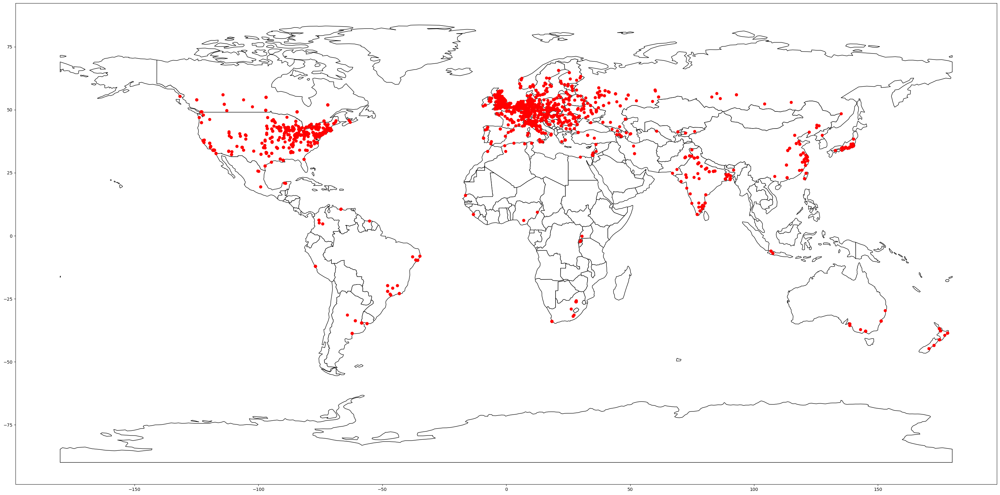

In [14]:
### Cartographier de toutes les naissances de personnes


# If we want to restrict to South America.
# world.clip([-90, -55, -25, 15])

ax = world.plot(color="white", edgecolor="black", figsize=(40,30))

# We can now plot our ``GeoDataFrame``.
birth_gdf.plot(ax=ax, color="red")

plt.show()

## Préparer et nettoyer les données


### Les lieux de naissance

In [16]:
df[['birthPlace', 'latitudeBirth', 'longitudeBirth']].head(2)

,birthPlace,latitudeBirth,longitudeBirth
0,Ferrara,44.8333,11.6167
1,Bologna,44.4939,11.3428


In [17]:
### Regrouper par lieu de naissance
df_lieux = pd.DataFrame(df.groupby(by=['birthPlace', 'latitudeBirth', 'longitudeBirth']).size())
df_lieux.reset_index(inplace = True)
df_lieux.columns=('birthPlace', 'latitude', 'longitude', 'effectif')
df_lieux.sort_values(by='effectif', ascending=False).head()

,birthPlace,latitude,longitude,effectif
771,New_York_City,40.7128,-74.0061,155
725,Moscow,55.7558,37.6172,101
163,Budapest,47.4925,19.0514,78
770,New_York_(state),43.0000,-76.0000,77
102,Berlin,52.5200,13.4050,47


### Les géolocalisations des organisations

In [18]:
df[['organisation','latitudeOrg', 'longitudeOrg']].head(2)

,organisation,latitudeOrg,longitudeOrg
0,University_of_Florence,43.7778,11.2586
1,University_of_Bologna,44.4939,11.3428


In [19]:
### Regrouper par siège d'organisation
df_org = pd.DataFrame(df.groupby(by=['organisation','latitudeOrg', 'longitudeOrg']).size())
df_org.reset_index(inplace = True)
df_org.columns=('organisation', 'latitude', 'longitude', 'effectif')
df_org.sort_values(by='effectif', ascending=False).head()

,organisation,latitude,longitude,effectif
175,Harvard_University,42.3744,-71.1169,158
370,Princeton_University,40.3453,-74.6561,146
525,University_of_Cambridge,52.2053,0.1172,113
531,University_of_Chicago,41.7897,-87.5997,111
518,"University_of_California,_Berkeley",37.8719,-122.2585,98


### Traiter les doublons de personnes

In [20]:
### Regrouper et compter par personne, lieu de naissance, organisation

person = pd.DataFrame(df.groupby(by=['subject_uri', 'BirthYear', 'birthPlace', 'r_property', 'organisation']).size())
person.reset_index(inplace=True)
person.columns = ("subject_uri","BirthYear","birthPlace", "r_property","organisation", "effectif")
#person.head()
show(person.sort_values(by="effectif",ascending=False))

In [21]:
person.groupby(by=["subject_uri"]).size().sort_values(ascending=False).head(8)

subject_uri
Ziauddin_Ahmad            18
Robert_Tarjan             18
Milton_Friedman           16
Franklin_E._Roach         12
Alastair_G._W._Cameron    12
Abdus_Salam               12
Keith_Devlin              11
Jocelyn_Bell_Burnell      10
dtype: int64

In [22]:
df.loc[df.subject_uri=="Franklin_E._Roach"]

,subject_uri,birthPlace,r_property,organisation,BirthYear,latitudeBirth,longitudeBirth,latitudeOrg,longitudeOrg
1216,Franklin_E._Roach,"Ottawa_County,_Michigan",almaMater,University_of_Chicago,1905,42.92,-86.23,41.7897,-87.5997
1217,Franklin_E._Roach,"Ottawa_County,_Michigan",almaMater,University_of_Michigan,1905,42.92,-86.23,42.2769,-83.7381
1218,Franklin_E._Roach,"Ottawa_County,_Michigan",almaMater,Wheaton_College_(Illinois),1905,42.92,-86.23,41.8703,-88.0986
1219,Franklin_E._Roach,"Ottawa_County,_Michigan",almaMater,Ohio_State_University,1905,42.92,-86.23,40.0053,-83.0285
1220,Franklin_E._Roach,"Jamestown_Charter_Township,_Michigan",almaMater,University_of_Chicago,1905,42.82,-85.84,41.7897,-87.5997
1221,Franklin_E._Roach,"Jamestown_Charter_Township,_Michigan",almaMater,University_of_Michigan,1905,42.82,-85.84,42.2769,-83.7381
1222,Franklin_E._Roach,"Jamestown_Charter_Township,_Michigan",almaMater,Wheaton_College_(Illinois),1905,42.82,-85.84,41.8703,-88.0986
1223,Franklin_E._Roach,"Jamestown_Charter_Township,_Michigan",almaMater,Ohio_State_University,1905,42.82,-85.84,40.0053,-83.0285
1224,Franklin_E._Roach,Michigan,almaMater,University_of_Chicago,1905,44.00,-85.00,41.7897,-87.5997
1225,Franklin_E._Roach,Michigan,almaMater,University_of_Michigan,1905,44.00,-85.00,42.2769,-83.7381


In [23]:
pp = pd.DataFrame(df.groupby(by=['subject_uri', 'BirthYear','r_property', 'organisation']).apply(lambda x : max(x.birthPlace)))
pp.reset_index(inplace=True)
pp.columns = ("subject_uri","birthYear","r_property", "organisation","birthPlace")

pp.head()

,subject_uri,birthYear,r_property,organisation,birthPlace
0,A._E._Douglass,1867,almaMater,Trinity_College_(Connecticut),"Windsor,_Vermont"
1,A._T._Mann,1943,almaMater,Cornell_University,New_York_(state)
2,Aaron_Pixton,1986,almaMater,Princeton_University,"Binghamton,_New_York"
3,Aaron_Pixton,1986,institution,Harvard_University,"Binghamton,_New_York"
4,Aaron_Pixton,1986,institution,University_of_Michigan,"Binghamton,_New_York"


In [24]:
pp.groupby(by=["subject_uri","birthPlace"]).size().sort_values(ascending=False).head(8)

subject_uri                     birthPlace                
Abdus_Salam                     Jhang                         12
Keith_Devlin                    Kingston_upon_Hull            11
Jocelyn_Bell_Burnell            Lurgan                        10
Paul_Erdős                      Budapest                      10
Ziauddin_Ahmad                  North-Western_Provinces        9
Roger_Penrose                   Colchester                     9
Robert_Tarjan                   Pomona,_California             9
Sydney_Chapman_(mathematician)  Eccles,_Greater_Manchester     9
dtype: int64

In [25]:
pp.loc[pp.subject_uri=="Paul_Erdős"]

,subject_uri,birthYear,r_property,organisation,birthPlace
2627,Paul_Erdős,1913,almaMater,Eötvös_Loránd_University,Budapest
2628,Paul_Erdős,1913,institution,Hebrew_University_of_Jerusalem,Budapest
2629,Paul_Erdős,1913,institution,Princeton_University,Budapest
2630,Paul_Erdős,1913,institution,Purdue_University,Budapest
2631,Paul_Erdős,1913,institution,Stanford_University,Budapest
2632,Paul_Erdős,1913,institution,Syracuse_University,Budapest
2633,Paul_Erdős,1913,institution,Technion_–_Israel_Institute_of_Technology,Budapest
2634,Paul_Erdős,1913,institution,University_of_Notre_Dame,Budapest
2635,Paul_Erdős,1913,institution,University_of_Pennsylvania,Budapest
2636,Paul_Erdős,1913,institution,Victoria_University_of_Manchester,Budapest


In [26]:
### On remarque qu'il n'y a plus de doublons à cause des lieux de naissance
# que des valeur uniques pour ces trois éléments
# La table pp contient donc les données nettoyées
pp.groupby(by=["subject_uri","birthYear","r_property", "organisation"]).size().sort_values(ascending=False).head(8)

subject_uri          birthYear  r_property   organisation                      
A._E._Douglass       1867       almaMater    Trinity_College_(Connecticut)         1
Max_Dehn             1878       institution  Goethe_University_Frankfurt           1
Melvin_Hochster      1943       almaMater    Harvard_University                    1
                                             Princeton_University                  1
                                institution  University_of_Michigan                1
Melvyn_B._Nathanson  1944       almaMater    University_of_Pennsylvania            1
                                             University_of_Rochester               1
Merieme_Chadid       1969       almaMater    University_of_Hassan_II_Casablanca    1
dtype: int64

### Ajouter les périodes

In [27]:
min(pp.birthYear), max(pp.birthYear)

(1454, 1989)

(1454.0, 1989.0)

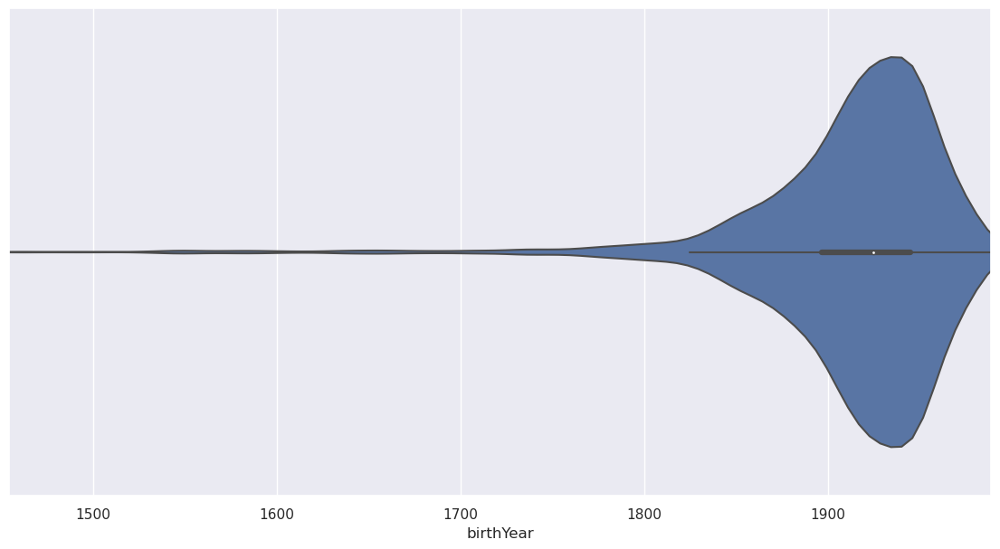

In [28]:
### Violinplot : densité des naissances dans le temps
#  https://mode.com/blog/violin-plot-examples/
#  https://seaborn.pydata.org/generated/seaborn.violinplot.html#seaborn.violinplot

sns.set_theme(style="whitegrid")

sns.set(rc={"figure.figsize":(14, 7)})

a = pp.birthYear
lim_left=min(a)
lim_right=max(a)

ax = sns.violinplot(x=a)

### Noter que au delà des limites les valeurs sont coupées car postulées
ax.set_xlim(left=lim_left, right=lim_right)

In [29]:
### Choisir des points dans le temps
# en fonction de la problématique ou heuristique
cuts = [1451, 1801, 1851, 1901, 1951, 2001]

In [30]:
pp['cut'] = pd.cut(pp['birthYear'], bins=cuts, right=False )#, labels=cuts[:-1])
pp.head(2)

,subject_uri,birthYear,r_property,organisation,birthPlace,cut
0,A._E._Douglass,1867,almaMater,Trinity_College_(Connecticut),"Windsor,_Vermont","[1851, 1901)"
1,A._T._Mann,1943,almaMater,Cornell_University,New_York_(state),"[1901, 1951)"


In [31]:
pp['cut'] = pp['cut'].apply(lambda x : str(int(x.left))+'-'+ str(int(x.right)-1))
pp['cut'][:2]

0    1851-1900
1    1901-1950
Name: cut, dtype: category
Categories (5, object): ['1451-1800' < '1801-1850' < '1851-1900' < '1901-1950' < '1951-2000']

In [32]:
### Distribution des naissances par période
pd.DataFrame(pp.groupby(by=['cut']).size().reset_index(name='effectif'))

,cut,effectif
0,1451-1800,119
1,1801-1850,169
2,1851-1900,675
3,1901-1950,1990
4,1951-2000,661


## Cartographier les naissances par périodes

In [33]:
birth_period = pd.DataFrame(pp.groupby(by=['birthPlace', 'cut']).size().reset_index(name='effectif'))
birth_period.columns=['birthPlace', 'year_begin', 'effectif']
birth_period.head()

,birthPlace,year_begin,effectif
0,7th_arrondissement_of_Paris,1451-1800,0
1,7th_arrondissement_of_Paris,1801-1850,0
2,7th_arrondissement_of_Paris,1851-1900,2
3,7th_arrondissement_of_Paris,1901-1950,0
4,7th_arrondissement_of_Paris,1951-2000,0


In [34]:
### Ajouter les coordonnées des lieux de naissance 
bp_loc = pd.merge(birth_period, df_lieux, how='inner', left_on='birthPlace', 
                                     right_on='birthPlace', suffixes=('_periode', '_total')
              )
bp_loc.head()

,birthPlace,year_begin,effectif_periode,latitude,longitude,effectif_total
0,7th_arrondissement_of_Paris,1451-1800,0,48.8592,2.3128,2
1,7th_arrondissement_of_Paris,1801-1850,0,48.8592,2.3128,2
2,7th_arrondissement_of_Paris,1851-1900,2,48.8592,2.3128,2
3,7th_arrondissement_of_Paris,1901-1950,0,48.8592,2.3128,2
4,7th_arrondissement_of_Paris,1951-2000,0,48.8592,2.3128,2


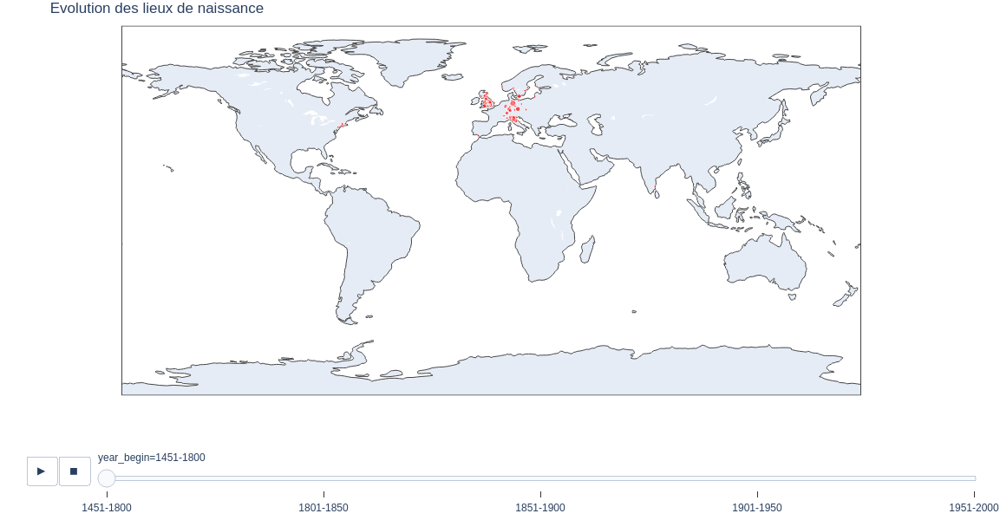

In [55]:
# now just plot it on a map with evolution by time
# https://plotly.com/python/animations/
# https://plotly.com/python/scatter-plots-on-maps/

# np.log(s) * 1000
size = [s if s != 0 else 0 for s in bp_loc.effectif_periode]

fig = px.scatter_geo(
    bp_loc,
    lat="latitude",
    lon="longitude",
    size=size,
    hover_name = "birthPlace",
    animation_frame="year_begin",
    width=1400, height=600,
    color_discrete_sequence=['red'],
    title="Evolution des lieux de naissance"
).update_layout(
    #mapbox_style='stamen-watercolor',
    #mapbox={"style": "carto-positron", "zoom":10},
    margin={"l": 0, "r": 20, "t": 30, "b": 0}

)

### Enregistrer l'image, puis l'ouvrir dans un autre onglet du navigateur
f_address = "pictures/birth_places.html"
fig.write_html(f_address)
fig.show()

### Grouper et compter les naissances par État contemporain

In [38]:
### Polygones des États contemporains
world.head()

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,889953.0,Oceania,Fiji,FJI,5496,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,58005463.0,Africa,Tanzania,TZA,63177,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253.0,Africa,W. Sahara,ESH,907,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,37589262.0,North America,Canada,CAN,1736425,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,328239523.0,North America,United States of America,USA,21433226,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."


In [39]:
## Projection des polygones
world.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [40]:
bp_loc.head()

,birthPlace,year_begin,effectif_periode,latitude,longitude,effectif_total
0,7th_arrondissement_of_Paris,1451-1800,0,48.8592,2.3128,2
1,7th_arrondissement_of_Paris,1801-1850,0,48.8592,2.3128,2
2,7th_arrondissement_of_Paris,1851-1900,2,48.8592,2.3128,2
3,7th_arrondissement_of_Paris,1901-1950,0,48.8592,2.3128,2
4,7th_arrondissement_of_Paris,1951-2000,0,48.8592,2.3128,2


In [41]:
### Transformer les coordonnées géogr. en points
bp_loc_gdf = gpd.GeoDataFrame(
    bp_loc[['birthPlace', 'effectif_periode', 'year_begin']],\
    geometry=gpd.points_from_xy(bp_loc.longitude, bp_loc.latitude), crs="EPSG:4326"
)

bp_loc_gdf.head(3)


,birthPlace,effectif_periode,year_begin,geometry
0,7th_arrondissement_of_Paris,0,1451-1800,POINT (2.31280 48.85920)
1,7th_arrondissement_of_Paris,0,1801-1850,POINT (2.31280 48.85920)
2,7th_arrondissement_of_Paris,2,1851-1900,POINT (2.31280 48.85920)


In [42]:
### Vérification
bp_loc_gdf.loc[bp_loc_gdf['birthPlace']=='Fresno,_California']

,birthPlace,effectif_periode,year_begin,geometry
1555,"Fresno,_California",0,1451-1800,POINT (-119.76670 36.75000)
1556,"Fresno,_California",0,1801-1850,POINT (-119.76670 36.75000)
1557,"Fresno,_California",0,1851-1900,POINT (-119.76670 36.75000)
1558,"Fresno,_California",6,1901-1950,POINT (-119.76670 36.75000)
1559,"Fresno,_California",0,1951-2000,POINT (-119.76670 36.75000)


In [43]:
### Projection des points :
# doit être la même que celle des polygones 
bp_loc_gdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [44]:
### Jointure spatiale, par défault inner join
# vérifie si un point se trouve dans un polygone 
# et ajoute le pays du polygone
bp_loc_join = bp_loc_gdf.sjoin(world)

In [45]:
show(bp_loc_join.sort_values(by='year_begin'), classes="display", scrollY="200px", 
     scrollCollapse=True, paging=False, column_filters="footer", dom="lrtip")

In [46]:
### Vérification
bp_loc_join.loc[bp_loc_join['birthPlace']=='Fresno,_California']

,birthPlace,effectif_periode,year_begin,geometry,index_right,pop_est,continent,name,iso_a3,gdp_md_est
1555,"Fresno,_California",0,1451-1800,POINT (-119.76670 36.75000),4,328239523.0,North America,United States of America,USA,21433226
1556,"Fresno,_California",0,1801-1850,POINT (-119.76670 36.75000),4,328239523.0,North America,United States of America,USA,21433226
1557,"Fresno,_California",0,1851-1900,POINT (-119.76670 36.75000),4,328239523.0,North America,United States of America,USA,21433226
1558,"Fresno,_California",6,1901-1950,POINT (-119.76670 36.75000),4,328239523.0,North America,United States of America,USA,21433226
1559,"Fresno,_California",0,1951-2000,POINT (-119.76670 36.75000),4,328239523.0,North America,United States of America,USA,21433226


In [47]:
### Regrouper par pays et époque, additionner les effectifs
birth_country = pd.DataFrame(bp_loc_join[['name', 'year_begin', 'effectif_periode', 'iso_a3']].groupby(by=['name','year_begin']).sum('effectif_periode').reset_index())
birth_country.columns=['name', 'year_begin', 'somme_effectif']
birth_country.head(10)

,name,year_begin,somme_effectif
0,Algeria,1451-1800,0
1,Algeria,1801-1850,0
2,Algeria,1851-1900,0
3,Algeria,1901-1950,5
4,Algeria,1951-2000,0
5,Argentina,1451-1800,0
6,Argentina,1801-1850,0
7,Argentina,1851-1900,0
8,Argentina,1901-1950,11
9,Argentina,1951-2000,10


In [48]:
### Transformer en json
countries_polygons = world[['name', 'geometry']]
countries_polygons.index = countries_polygons['name']
countries_polygons = countries_polygons.drop(['name'], axis=1)
countries_polygons_json = json.loads(countries_polygons.to_json())
countries_polygons.head()

,geometry
name,
Fiji,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
Tanzania,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
W. Sahara,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
Canada,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
United States of America,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."


In [49]:
### Le pays avec le plus de naissances par période
birth_country[birth_country.somme_effectif==max(birth_country.somme_effectif)]

,name,year_begin,somme_effectif
333,United States of America,1901-1950,644


In [50]:
### Distribution des effectifs des naissances
birth_country.somme_effectif.describe()

count    345.000000
mean      10.397101
std       41.705313
min        0.000000
25%        0.000000
50%        1.000000
75%        6.000000
max      644.000000
Name: somme_effectif, dtype: float64

In [51]:
### Distribution dans le dernier quartile
birth_country[birth_country.somme_effectif>6].somme_effectif.describe()

count     84.000000
mean      39.630952
std       77.825845
min        7.000000
25%       11.000000
50%       18.000000
75%       37.750000
max      644.000000
Name: somme_effectif, dtype: float64

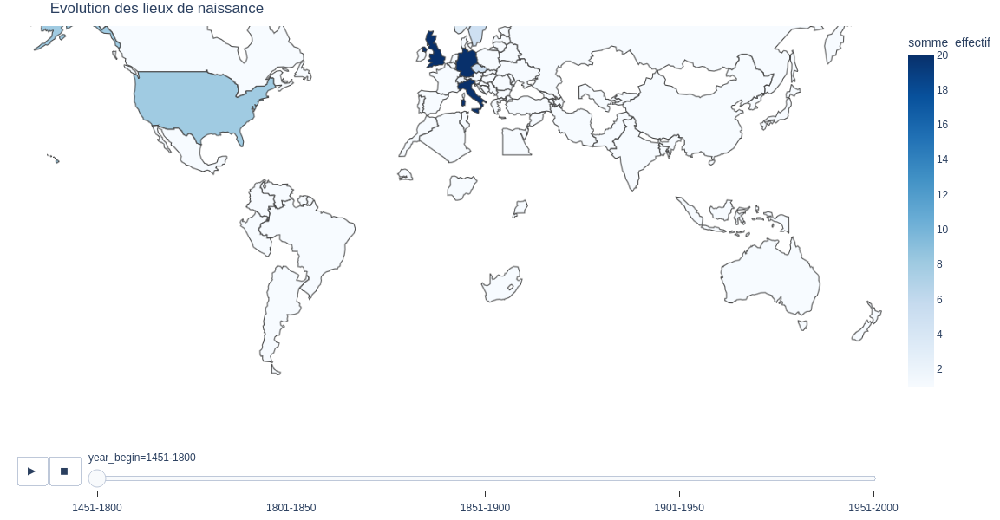

In [56]:
# Représenter la densité de naissances de mathématiciens par pays
# https://plotly.com/python/animations/
# https://plotly.com/python-api-reference/generated/plotly.express.choropleth_mapbox.html
# https://medium.com/@lucas_bromerchenkel/choropleth-maps-with-time-sliders-using-plotly-df6e19e5f90c

# np.log(s) * 1000
size = [s if s != 0 else 0 for s in bp_loc.effectif_periode]

fig = px.choropleth_mapbox(
    birth_country,
    geojson=countries_polygons_json,
    locations="name",
    color="somme_effectif",
    mapbox_style='white-bg',
    zoom=1,
    color_continuous_scale='blues',
    ### valeur 20 définie en fonction de la distribution par pays
    # expérimenter en changeant la valeur
    range_color=(1, 20),
    animation_frame="year_begin",
    width=1000, height=600,
    title="Evolution des lieux de naissance"
).update_layout(
    #mapbox={"style": "carto-positron", "zoom":10},
    margin={"l": 0, "r": 0, "t": 30, "b": 0}

)
### Enregistrer l'image, puis l'ouvrir dans un autre onglet du navigateur
f_address = "pictures/birth_places_choropleth.html"
fig.write_html(f_address)

fig.show()

## Cartographier les organisations par périodes

In [57]:
org_period = pd.DataFrame(pp.groupby(by=['organisation', 'cut']).size().reset_index(name='effectif'))
org_period.columns=['organisation', 'year_begin', 'effectif']
org_period.head()

,organisation,year_begin,effectif
0,Aarhus_University,1451-1800,0
1,Aarhus_University,1801-1850,0
2,Aarhus_University,1851-1900,0
3,Aarhus_University,1901-1950,1
4,Aarhus_University,1951-2000,0


In [58]:
### Ajouter les coordonnées des lieux de naissance 
org_loc = pd.merge(org_period, df_org, how='inner', left_on='organisation', 
                                     right_on='organisation', suffixes=('_periode', '_total')
              )
org_loc.head()

,organisation,year_begin,effectif_periode,latitude,longitude,effectif_total
0,Aarhus_University,1451-1800,0,56.1706,10.2011,1
1,Aarhus_University,1801-1850,0,56.1706,10.2011,1
2,Aarhus_University,1851-1900,0,56.1706,10.2011,1
3,Aarhus_University,1901-1950,1,56.1706,10.2011,1
4,Aarhus_University,1951-2000,0,56.1706,10.2011,1


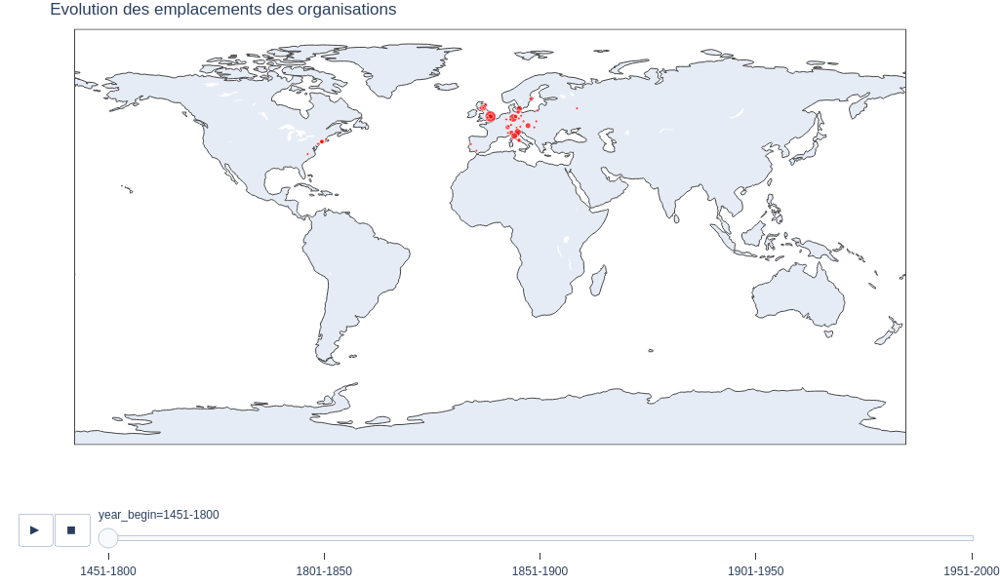

In [59]:
# now just plot it on a map with evolution by time
# https://plotly.com/python/animations/


size = [s if s != 0 else 0 for s in org_loc.effectif_periode]

px.scatter_geo(
    org_loc,
    lat="latitude",
    lon="longitude",
    size=size,
    hover_name = "organisation",
    animation_frame="year_begin",
    width=1200, height=600,
    color_discrete_sequence=['red'], 
    title="Evolution des emplacements des organisations" 
).update_layout(
     mapbox={"style": "carto-positron", "zoom":11},
    margin={"l": 0, "r": 20, "t": 30, "b": 0}

)


### Grouper et compter les appartenance aux organisations par État contemporain

In [60]:
org_loc.head()

,organisation,year_begin,effectif_periode,latitude,longitude,effectif_total
0,Aarhus_University,1451-1800,0,56.1706,10.2011,1
1,Aarhus_University,1801-1850,0,56.1706,10.2011,1
2,Aarhus_University,1851-1900,0,56.1706,10.2011,1
3,Aarhus_University,1901-1950,1,56.1706,10.2011,1
4,Aarhus_University,1951-2000,0,56.1706,10.2011,1


In [61]:
### Transformer les coordonnées géogr. en points
org_loc_gdf = gpd.GeoDataFrame(
    org_loc[['organisation', 'effectif_periode', 'year_begin']],\
    geometry=gpd.points_from_xy(org_loc.longitude, org_loc.latitude), crs="EPSG:4326"
)

org_loc_gdf.head(5)


,organisation,effectif_periode,year_begin,geometry
0,Aarhus_University,0,1451-1800,POINT (10.20110 56.17060)
1,Aarhus_University,0,1801-1850,POINT (10.20110 56.17060)
2,Aarhus_University,0,1851-1900,POINT (10.20110 56.17060)
3,Aarhus_University,1,1901-1950,POINT (10.20110 56.17060)
4,Aarhus_University,0,1951-2000,POINT (10.20110 56.17060)


In [62]:
### Projection des points :
# doit être la même que celle des polygones 
org_loc_gdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [63]:
### Jointure spatiale, par défault inner join
# vérifie si un point se trouve dans un polygone 
# et ajoute le pays du polygone
org_loc_join = org_loc_gdf.sjoin(world)

In [64]:
show(org_loc_join.sort_values(by='year_begin'), classes="display", scrollY="200px", 
     scrollCollapse=True, paging=False, column_filters="footer", dom="lrtip")

In [65]:
### Vérification
org_loc_join.loc[org_loc_join['organisation']=='Indiana_University']

,organisation,effectif_periode,year_begin,geometry,index_right,pop_est,continent,name,iso_a3,gdp_md_est
970,Indiana_University,0,1451-1800,POINT (-86.50000 39.16670),4,328239523.0,North America,United States of America,USA,21433226
971,Indiana_University,0,1801-1850,POINT (-86.50000 39.16670),4,328239523.0,North America,United States of America,USA,21433226
972,Indiana_University,2,1851-1900,POINT (-86.50000 39.16670),4,328239523.0,North America,United States of America,USA,21433226
973,Indiana_University,6,1901-1950,POINT (-86.50000 39.16670),4,328239523.0,North America,United States of America,USA,21433226
974,Indiana_University,0,1951-2000,POINT (-86.50000 39.16670),4,328239523.0,North America,United States of America,USA,21433226


In [66]:
### Regrouper par pays et époque, additionner les effectifs
org_country = pd.DataFrame(org_loc_join[['name', 'year_begin', 'effectif_periode', 'iso_a3']].groupby(by=['name', 'year_begin']).sum('effectif_periode').reset_index())
org_country.columns=['name', 'year_begin', 'somme_effectif']
org_country.head(10)

,name,year_begin,somme_effectif
0,Argentina,1451-1800,0
1,Argentina,1801-1850,0
2,Argentina,1851-1900,1
3,Argentina,1901-1950,7
4,Argentina,1951-2000,6
5,Armenia,1451-1800,0
6,Armenia,1801-1850,0
7,Armenia,1851-1900,0
8,Armenia,1901-1950,7
9,Armenia,1951-2000,1


In [67]:
### Transformer en json

# countries_polygons_json créé ci-dessus

In [68]:
### Le pays avec le plus d'organisations par période
org_country[org_country.somme_effectif==max(org_country.somme_effectif)]

,name,year_begin,somme_effectif
303,United States of America,1901-1950,942


In [69]:
### Distribution des effectifs des appartenances aux organisations
org_country.somme_effectif.describe()

count    315.000000
mean      11.330159
std       59.727717
min        0.000000
25%        0.000000
50%        1.000000
75%        5.000000
max      942.000000
Name: somme_effectif, dtype: float64

In [70]:
### Distribution dans le dernier quartile
org_country[org_country.somme_effectif>6].somme_effectif.describe()

count     68.000000
mean      49.117647
std      121.911582
min        7.000000
25%       10.000000
50%       18.000000
75%       35.500000
max      942.000000
Name: somme_effectif, dtype: float64

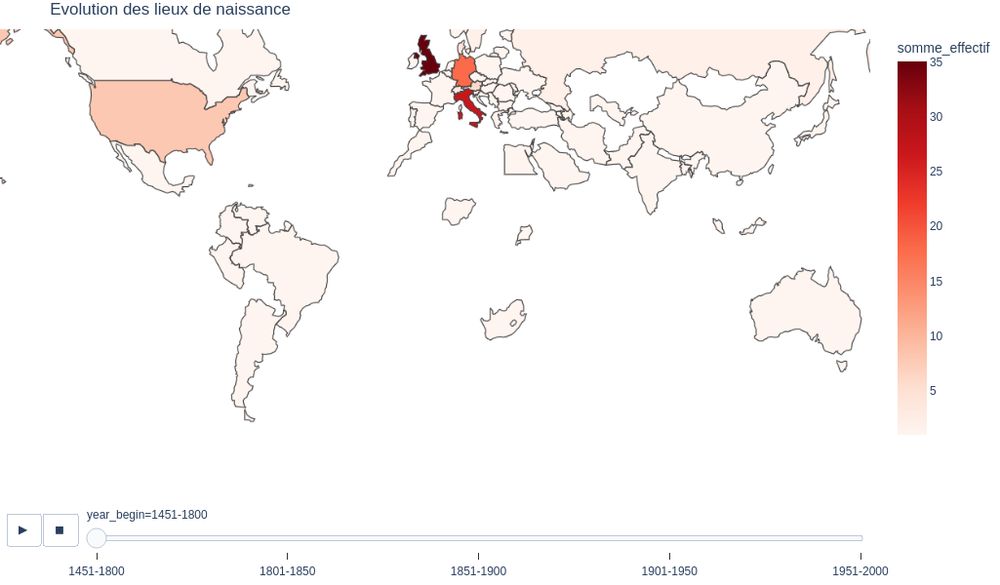

In [71]:
# Représenter la densité de naissances de mathématiciens par pays
# https://plotly.com/python/animations/
# https://plotly.com/python-api-reference/generated/plotly.express.choropleth_mapbox.html
# https://medium.com/@lucas_bromerchenkel/choropleth-maps-with-time-sliders-using-plotly-df6e19e5f90c

# np.log(s) * 1000
size = [s if s != 0 else 0 for s in org_loc.effectif_periode]

px.choropleth_mapbox(
    org_country,
    geojson=countries_polygons_json,
    locations="name",
    color="somme_effectif",

    mapbox_style='white-bg',
    zoom=1,
    color_continuous_scale='reds',
    ### valeur 20 définie en fonction de la distribution par pays
    # expérimenter en changeant la valeur
    range_color=(1, 35),
    animation_frame="year_begin",
    width=1000, height=600,
    title="Evolution des lieux de naissance"
).update_layout(
    #mapbox={"style": "carto-positron", "zoom":10},
    margin={"l": 0, "r": 0, "t": 30, "b": 0}

)


## Créer les pairs d'organisations

In [72]:
### Reprendre la liste nettoyée des personnes
pp.head()

,subject_uri,birthYear,r_property,organisation,birthPlace,cut
0,A._E._Douglass,1867,almaMater,Trinity_College_(Connecticut),"Windsor,_Vermont",1851-1900
1,A._T._Mann,1943,almaMater,Cornell_University,New_York_(state),1901-1950
2,Aaron_Pixton,1986,almaMater,Princeton_University,"Binghamton,_New_York",1951-2000
3,Aaron_Pixton,1986,institution,Harvard_University,"Binghamton,_New_York",1951-2000
4,Aaron_Pixton,1986,institution,University_of_Michigan,"Binghamton,_New_York",1951-2000


In [73]:
### Reprendre la liste des organisations spatialisées
org_loc_join.head()

,organisation,effectif_periode,year_begin,geometry,index_right,pop_est,continent,name,iso_a3,gdp_md_est
0,Aarhus_University,0,1451-1800,POINT (10.20110 56.17060),142,5818553.0,Europe,Denmark,DNK,350104
1,Aarhus_University,0,1801-1850,POINT (10.20110 56.17060),142,5818553.0,Europe,Denmark,DNK,350104
2,Aarhus_University,0,1851-1900,POINT (10.20110 56.17060),142,5818553.0,Europe,Denmark,DNK,350104
3,Aarhus_University,1,1901-1950,POINT (10.20110 56.17060),142,5818553.0,Europe,Denmark,DNK,350104
4,Aarhus_University,0,1951-2000,POINT (10.20110 56.17060),142,5818553.0,Europe,Denmark,DNK,350104


In [74]:
org_country = pd.DataFrame(org_loc_join.groupby(by=["organisation", "name"]).sum("effectif_periode"))
org_country = org_country.reset_index()
org_country = org_country.drop(columns=["index_right", "pop_est", "gdp_md_est"])
org_country.columns=["organisation", "name", "effectif_total"]
org_country.sort_values(by="effectif_total", ascending=False ).head()

,organisation,name,effectif_total
361,Princeton_University,United States of America,128
173,Harvard_University,United States of America,126
512,University_of_Cambridge,United Kingdom,102
285,Moscow_State_University,Russia,93
517,University_of_Chicago,United States of America,85


In [75]:
ppm = pd.merge(pp, org_country, left_on="organisation", right_on="organisation", suffixes=('_p', '_y'))
ppm.head()

,subject_uri,birthYear,r_property,organisation,birthPlace,cut,name,effectif_total
0,A._E._Douglass,1867,almaMater,Trinity_College_(Connecticut),"Windsor,_Vermont",1851-1900,United States of America,1
1,A._T._Mann,1943,almaMater,Cornell_University,New_York_(state),1901-1950,United States of America,38
2,Abdulalim_A._Shabazz,1927,almaMater,Cornell_University,"Bessemer,_Alabama",1901-1950,United States of America,38
3,Alex_F._T._W._Rosenberg,1926,institution,Cornell_University,Berlin,1901-1950,United States of America,38
4,Dorothy_Brady,1903,almaMater,Cornell_University,Minnesota,1901-1950,United States of America,38


In [76]:
[p for p in ppm.values][:2]

[array(['A._E._Douglass', 1867, 'almaMater',
        'Trinity_College_(Connecticut)', 'Windsor,_Vermont', '1851-1900',
        'United States of America', 1], dtype=object),
 array(['A._T._Mann', 1943, 'almaMater', 'Cornell_University',
        'New_York_(state)', '1901-1950', 'United States of America', 38],
       dtype=object)]

In [77]:
## Pairs d'organisations
pairs_o = []

for s1 in ppm.sort_values(by='organisation').values:
    for s2 in ppm.sort_values(by='organisation').values:
        if s1[3] < s2[3] \
            and s1[0] == s2[0]:
                pairs_o.append([s1[3],s2[3], s1[5], s1[6], s2[6]])
        else:
            pass

In [78]:
len(pairs_o), pairs_o[:2]

(3126,
 [['Aarhus_University',
   'University_of_Bristol',
   '1901-1950',
   'Denmark',
   'United Kingdom'],
  ['Aarhus_University',
   'University_of_Chicago',
   '1901-1950',
   'Denmark',
   'United States of America']])

In [79]:
### Créér dataframe et compter
liens_org = pd.DataFrame(pairs_o)
liens_org.columns=('org_1', 'org_2', 'periode', 'etat_1', 'etat_2')
liens_org.head()

,org_1,org_2,periode,etat_1,etat_2
0,Aarhus_University,University_of_Bristol,1901-1950,Denmark,United Kingdom
1,Aarhus_University,University_of_Chicago,1901-1950,Denmark,United States of America
2,Accademia_Pontaniana,University_of_Naples_Federico_II,1851-1900,Italy,Italy
3,Achva_Academic_College,Ben-Gurion_University_of_the_Negev,1901-1950,Israel,Israel
4,Achva_Academic_College,Ohio_State_University,1901-1950,Israel,United States of America


In [80]:
liens_org_grp = pd.DataFrame(liens_org.groupby(by=['org_1', 'org_2', 'periode']).size())
liens_org_grp=liens_org_grp.reset_index()
liens_org_grp.columns=['org_1', 'org_2', 'periode', 'effectif']
liens_org_grp.sort_values(by='effectif', ascending=False).head()

,org_1,org_2,periode,effectif
828,Harvard_University,Princeton_University,1901-1950,11
1528,Princeton_University,Stanford_University,1951-2000,10
2194,University_of_Chicago,University_of_Michigan,1901-1950,10
2161,University_of_Cambridge,University_of_Oxford,1901-1950,9
850,Harvard_University,"University_of_California,_Berkeley",1901-1950,9


In [81]:
### Ajouter les coordonnées des lieux de naissance 
org_1_loc = pd.merge(liens_org_grp, df_org, how='inner', left_on='org_1', 
                                     right_on='organisation', suffixes=('_p', '_y')
              )
org_1_loc=org_1_loc.drop(columns=['organisation','effectif_y'])
org_1_loc.head()

,org_1,org_2,periode,effectif_p,latitude,longitude
0,Aarhus_University,University_of_Bristol,1901-1950,1,56.1706,10.2011
1,Aarhus_University,University_of_Chicago,1901-1950,1,56.1706,10.2011
2,Accademia_Pontaniana,University_of_Naples_Federico_II,1851-1900,1,40.8530,14.2479
3,Achva_Academic_College,Ben-Gurion_University_of_the_Negev,1901-1950,1,31.7442,34.7740
4,Achva_Academic_College,Ohio_State_University,1901-1950,1,31.7442,34.7740


In [82]:
### Ajouter les coordonnées des lieux de naissance 
orgs_loc = pd.merge(org_1_loc, df_org, how='inner', left_on='org_2', 
                                     right_on='organisation', suffixes=('_1', '_2')
              )
orgs_loc=orgs_loc.drop(columns=['organisation','effectif'])
orgs_loc.head()

,org_1,org_2,periode,effectif_p,latitude_1,longitude_1,latitude_2,longitude_2
0,Aarhus_University,University_of_Bristol,1901-1950,1,56.1706,10.2011,51.4564,-2.6044
1,Colby_College,University_of_Bristol,1901-1950,2,44.5642,-69.6631,51.4564,-2.6044
2,King's_College_London,University_of_Bristol,1901-1950,4,51.5119,-0.1161,51.4564,-2.6044
3,Princeton_University,University_of_Bristol,1951-2000,1,40.3453,-74.6561,51.4564,-2.6044
4,Stanford_University,University_of_Bristol,1901-1950,2,37.4282,-122.1689,51.4564,-2.6044


In [83]:
orgs_loc['geometry'] = orgs_loc.apply(lambda x: LineString([(x['longitude_1'], x['latitude_1']) , (x['longitude_2'], x['latitude_2'])]), axis = 1)
orgs_loc.head()

,org_1,org_2,periode,effectif_p,latitude_1,longitude_1,latitude_2,longitude_2,geometry
0,Aarhus_University,University_of_Bristol,1901-1950,1,56.1706,10.2011,51.4564,-2.6044,"LINESTRING (10.2011 56.1706, -2.6044 51.4564)"
1,Colby_College,University_of_Bristol,1901-1950,2,44.5642,-69.6631,51.4564,-2.6044,"LINESTRING (-69.6631 44.5642, -2.6044 51.4564)"
2,King's_College_London,University_of_Bristol,1901-1950,4,51.5119,-0.1161,51.4564,-2.6044,"LINESTRING (-0.1161 51.5119, -2.6044 51.4564)"
3,Princeton_University,University_of_Bristol,1951-2000,1,40.3453,-74.6561,51.4564,-2.6044,"LINESTRING (-74.6561 40.3453, -2.6044 51.4564)"
4,Stanford_University,University_of_Bristol,1901-1950,2,37.4282,-122.1689,51.4564,-2.6044,"LINESTRING (-122.1689 37.4282, -2.6044 51.4564)"


In [84]:
orgs_loc.columns

Index(['org_1', 'org_2', 'periode', 'effectif_p', 'latitude_1', 'longitude_1',
       'latitude_2', 'longitude_2', 'geometry'],
      dtype='object')

In [85]:
orgs_gdf = gpd.GeoDataFrame(
    orgs_loc[['org_1', 'org_2','periode','effectif_p', 'geometry']]
)

orgs_gdf.head(3)

,org_1,org_2,periode,effectif_p,geometry
0,Aarhus_University,University_of_Bristol,1901-1950,1,"LINESTRING (10.20110 56.17060, -2.60440 51.45640)"
1,Colby_College,University_of_Bristol,1901-1950,2,"LINESTRING (-69.66310 44.56420, -2.60440 51.45..."
2,King's_College_London,University_of_Bristol,1901-1950,4,"LINESTRING (-0.11610 51.51190, -2.60440 51.45640)"


In [86]:
orgs_gdf = orgs_gdf.set_geometry('geometry')
orgs_gdf = orgs_gdf.set_crs('EPSG:4326')
orgs_gdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

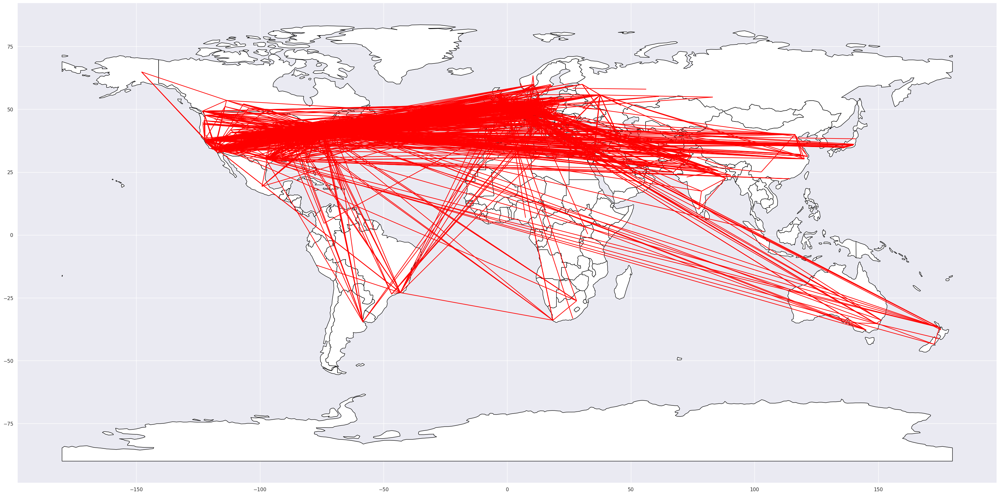

In [87]:
### Cartographier


# If we want to restrict to South America.
# world.clip([-90, -55, -25, 15])

ax = world.plot(color="white", edgecolor="black", figsize=(40,30))

# We can now plot our ``GeoDataFrame``.
orgs_gdf.plot(ax=ax, color="red")

plt.show()

In [88]:
orgs_loc.head()

,org_1,org_2,periode,effectif_p,latitude_1,longitude_1,latitude_2,longitude_2,geometry
0,Aarhus_University,University_of_Bristol,1901-1950,1,56.1706,10.2011,51.4564,-2.6044,"LINESTRING (10.2011 56.1706, -2.6044 51.4564)"
1,Colby_College,University_of_Bristol,1901-1950,2,44.5642,-69.6631,51.4564,-2.6044,"LINESTRING (-69.6631 44.5642, -2.6044 51.4564)"
2,King's_College_London,University_of_Bristol,1901-1950,4,51.5119,-0.1161,51.4564,-2.6044,"LINESTRING (-0.1161 51.5119, -2.6044 51.4564)"
3,Princeton_University,University_of_Bristol,1951-2000,1,40.3453,-74.6561,51.4564,-2.6044,"LINESTRING (-74.6561 40.3453, -2.6044 51.4564)"
4,Stanford_University,University_of_Bristol,1901-1950,2,37.4282,-122.1689,51.4564,-2.6044,"LINESTRING (-122.1689 37.4282, -2.6044 51.4564)"


In [89]:
orgs_loc.columns

Index(['org_1', 'org_2', 'periode', 'effectif_p', 'latitude_1', 'longitude_1',
       'latitude_2', 'longitude_2', 'geometry'],
      dtype='object')

In [90]:
orgs_loc = orgs_loc.sort_values(by='periode')

In [91]:
#
lats = []
for s in orgs_loc.values:
    lats.append(np.array(np.float64(s[4]), np.float64(s[6])))
lats[:3]

[array(45.4167), array(47.4667), array(52.2081)]

In [92]:
#
longs = []
for s in orgs_loc.values:
    longs.append(np.array(np.float64(s[5]), np.float64(s[7])))
longs[:3]

[array(11.8667), array(19.05), array(0.1167)]

In [94]:
#
names = []
for s in orgs_loc.values:
    names.append(s[0]+ '_' + s[1])
names[:3]

['University_of_Padua_University_of_Parma',
 'Buda_Jagiellonian_University',
 "St_John's_College,_Cambridge_Trinity_College,_Cambridge"]

In [95]:
#
size = []
for s in orgs_loc.values:
    size.append(s[3])
size[:3]

[1, 1, 2]

In [96]:
#
periodes = []
for s in orgs_loc.values:
    periodes.append(s[2])
periodes[:3]

['1451-1800', '1451-1800', '1451-1800']

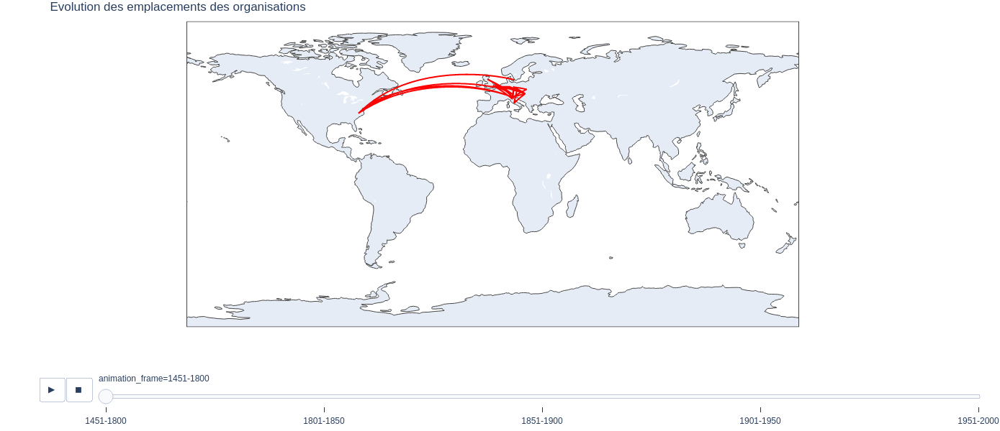

In [104]:
# now just plot it on a map with evolution by time
# https://plotly.com/python/animations/


size = [s if s != 0 else 0 for s in org_loc.effectif_periode]

size = [s if s != 0 else 0 for s in org_loc.effectif_periode]

"""px.scatter_geo(
    org_loc,
    lat="latitude",
    lon="longitude",
    size=size,
    hover_name = "organisation",
    animation_frame="year_begin",
    width=1200, height=600,
    color_discrete_sequence=['red'], 
    title="Evolution des emplacements des organisations" 
)"""

fig = px.line_geo(#data_frame=orgs_loc,
            lat=lats, lon=longs, 
       # hover_name=names,
    #size=size,
    animation_frame=periodes,
    width=1200, height=600,
    color_discrete_sequence=['red'], 
    title="Evolution des emplacements des organisations" 
).update_layout(
     mapbox={"style": "carto-positron", "zoom":11},
    margin={"l": 0, "r": 20, "t": 30, "b": 0}

)

### Enregistrer l'image, puis l'ouvrir dans un autre onglet du navigateur
f_address = "pictures/org_relationships.html"
fig.write_html(f_address)

fig.show()

### Observer plus finemenent

In [105]:
liens_etat_grp = pd.DataFrame(liens_org.groupby(by=['etat_1', 'etat_2', 'periode']).size())
liens_etat_grp=liens_etat_grp.reset_index()
liens_etat_grp.columns=['etat_1', 'etat_2', 'periode', 'effectif']
liens_etat_grp.sort_values(by='effectif', ascending=False).head()

,etat_1,etat_2,periode,effectif
408,United States of America,United States of America,1901-1950,756
409,United States of America,United States of America,1951-2000,228
335,United Kingdom,United Kingdom,1901-1950,219
407,United States of America,United States of America,1851-1900,172
336,United Kingdom,United Kingdom,1951-2000,88


In [106]:
liens_etat_grp['relation'] = liens_etat_grp.apply(lambda x : x.etat_1 + "-" + x.etat_2, axis=1)
liens_etat_grp.head()

,etat_1,etat_2,periode,effectif,relation
0,Argentina,Argentina,1951-2000,2,Argentina-Argentina
1,Argentina,Germany,1901-1950,1,Argentina-Germany
2,Argentina,Puerto Rico,1901-1950,1,Argentina-Puerto Rico
3,Argentina,United States of America,1901-1950,3,Argentina-United States of America
4,Argentina,United States of America,1951-2000,1,Argentina-United States of America


In [107]:
liste_relations = pd.DataFrame(liens_etat_grp.groupby(by='relation').sum('effectif'))
liste_relations = liste_relations.reset_index()
liste_relations.sort_values(by='effectif',ascending=False).head(10)

,relation,effectif
272,United States of America-United States of America,1164
236,United Kingdom-United Kingdom,377
271,United States of America-United Kingdom,140
83,Germany-Germany,104
123,Italy-Italy,74
237,United Kingdom-United States of America,68
243,United States of America-Canada,50
250,United States of America-Germany,43
185,Russia-Russia,38
130,Japan-Japan,33


In [108]:
l_rel = list(liste_relations.relation)
l_rel[:3]

['Argentina-Argentina', 'Argentina-Germany', 'Argentina-Puerto Rico']

In [109]:
### Distribution des naissances par période
df_cut = pd.DataFrame(pp.groupby(by=['cut']).size().reset_index(name='effectif'))
df_cut

,cut,effectif
0,1451-1800,119
1,1801-1850,169
2,1851-1900,675
3,1901-1950,1990
4,1951-2000,661


In [110]:
v_cut = list(df_cut.cut)
v_cut

['1451-1800', '1801-1850', '1851-1900', '1901-1950', '1951-2000']

In [111]:
toute_relation = []
for r in l_rel:
    for c in v_cut:
        toute_relation.append([r,c])
df_toute_rel = pd.DataFrame(toute_relation)
df_toute_rel.columns = ('relation', 'periode')
df_toute_rel.head(10)

,relation,periode
0,Argentina-Argentina,1451-1800
1,Argentina-Argentina,1801-1850
2,Argentina-Argentina,1851-1900
3,Argentina-Argentina,1901-1950
4,Argentina-Argentina,1951-2000
5,Argentina-Germany,1451-1800
6,Argentina-Germany,1801-1850
7,Argentina-Germany,1851-1900
8,Argentina-Germany,1901-1950
9,Argentina-Germany,1951-2000


In [112]:
merge_relations = pd.merge(df_toute_rel, liens_etat_grp[['periode', 'effectif', 'relation']], how='left',  left_on=['relation', 'periode'], right_on=['relation', 'periode'])
merge_relations.head(10)

,relation,periode,effectif
0,Argentina-Argentina,1451-1800,NaN
1,Argentina-Argentina,1801-1850,NaN
2,Argentina-Argentina,1851-1900,NaN
3,Argentina-Argentina,1901-1950,NaN
4,Argentina-Argentina,1951-2000,2.0
5,Argentina-Germany,1451-1800,NaN
6,Argentina-Germany,1801-1850,NaN
7,Argentina-Germany,1851-1900,NaN
8,Argentina-Germany,1901-1950,1.0
9,Argentina-Germany,1951-2000,NaN


In [113]:
merge_relations.effectif = merge_relations.effectif.fillna(0)
merge_relations.effectif= merge_relations.effectif.apply(lambda x : int(x))
merge_relations.head(10)

,relation,periode,effectif
0,Argentina-Argentina,1451-1800,0
1,Argentina-Argentina,1801-1850,0
2,Argentina-Argentina,1851-1900,0
3,Argentina-Argentina,1901-1950,0
4,Argentina-Argentina,1951-2000,2
5,Argentina-Germany,1451-1800,0
6,Argentina-Germany,1801-1850,0
7,Argentina-Germany,1851-1900,0
8,Argentina-Germany,1901-1950,1
9,Argentina-Germany,1951-2000,0


In [114]:
file_addr = 'data/merge_relations.csv'
merge_relations.to_csv(file_addr)

In [115]:
show(merge_relations)

In [116]:
list(merge_relations.sort_values(by='periode').periode.unique())

['1451-1800', '1801-1850', '1851-1900', '1901-1950', '1951-2000']

In [117]:
### Explorer par des filtres Pandas
liens_etat_grp[liens_etat_grp.periode=="1451-1800"].sort_values(by=["effectif"],ascending=False).head(10)

,etat_1,etat_2,periode,effectif,relation
169,Italy,Italy,1451-1800,7,Italy-Italy
107,Germany,Germany,1451-1800,4,Germany-Germany
332,United Kingdom,United Kingdom,1451-1800,4,United Kingdom-United Kingdom
405,United States of America,United States of America,1451-1800,3,United States of America-United States of America
13,Austria,Austria,1451-1800,2,Austria-Austria
164,Italy,Austria,1451-1800,2,Italy-Austria
309,United Kingdom,Germany,1451-1800,2,United Kingdom-Germany
63,Czechia,Austria,1451-1800,1,Czechia-Austria
64,Czechia,Poland,1451-1800,1,Czechia-Poland
70,Denmark,Germany,1451-1800,1,Denmark-Germany


### Création et utilisation d'une fonction d'affichage

In [118]:
# generate the plot

def generate_fig(df, country=None, load_image = False):
    
    if country:
        dataframe = df[df.relation.str.contains(country)]
    else:
        dataframe = df
    
    fig = px.bar(
        dataframe,
        x="effectif",
        y="relation",
        base="relation",
        #color="effectif",
        #orientation="h",
        height= len(dataframe)*5,
        width=1000,
        animation_frame="periode"

    )

    fig.update_layout(
        margin=dict(l=2, r=100, t=0, b=5),
        paper_bgcolor="LightSteelBlue",
        xaxis={"range":[0,list(merge_relations.effectif.quantile([0.99]))[0]]}
#                        dataframe.effectif.max()]}
    )
    
    ### enregistrer au format HTML et ouvrir comme page web
    if country:
        f_address = "pictures/countries_relations_" + country + ".html"
    else:
        f_address = "pictures/countries_relations.html"
    fig.write_html(f_address)

    ### On n'affiche pas l'image directement mais on la sauvegarde dans un fichier,
    # puis on affiche le fichier dans le carnet Jupyter avec l'instruction display.HMTL,
    # cf. ci-dessous. On peut aussi ouvrir le fichier dans une autre fenêtre
    
    if load_image == False:
        fig.show()
    else:
        i = IPython.display.HTML(filename=f_address)
        return i



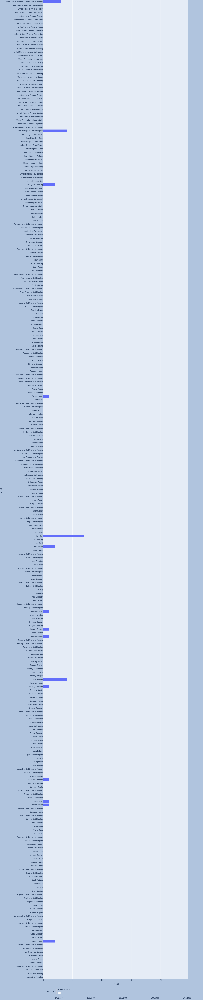

In [119]:
### inspecter le dataframe complet
df = merge_relations
generate_fig(df)

In [120]:
### Filtrer sur le nom d'un pays
generate_fig(df, 'Italy', load_image=True)